In [1]:
import numpy as np
import pandas as pd
import os
import random
import PIL
import PIL.Image
from IPython import display
from pathlib import Path
import PIL.ImageDraw
import ast
import cv2
import tqdm.notebook

In [2]:
DATA_DIR = Path('datasets/')
img_list = list(DATA_DIR.glob('images/*.jpg'))
print("Number of images: {}".format(len(img_list)))

Number of images: 103


Кількість зображень (навіть з сегментацією) не вистачить задля навчення моделі з нуля - варто буде використати вже натреновану модель, дотренувавши її на наших даних

In [3]:
pickone = random.choice(img_list)
img = PIL.Image.open(pickone)
IMAGE_HEIGHT, IMAGE_WIDTH = img.size
num_channels = len(img.mode)

In [4]:

# convert a string record into a valid python object
def f(x): 
    return ast.literal_eval(x.rstrip('\r\n'))

df = pd.read_csv(DATA_DIR / "annotations.csv", 
                converters={'geometry': f})
df.head(3)

,id,image_id,geometry,class
0,1,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(135, 522), (245, 522), (245, 600), (135, 600...",Airplane
1,2,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1025, 284), (1125, 284), (1125, 384), (1025,...",Airplane
2,3,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1058, 1503), (1130, 1503), (1130, 1568), (10...",Airplane


(2560, 2560)


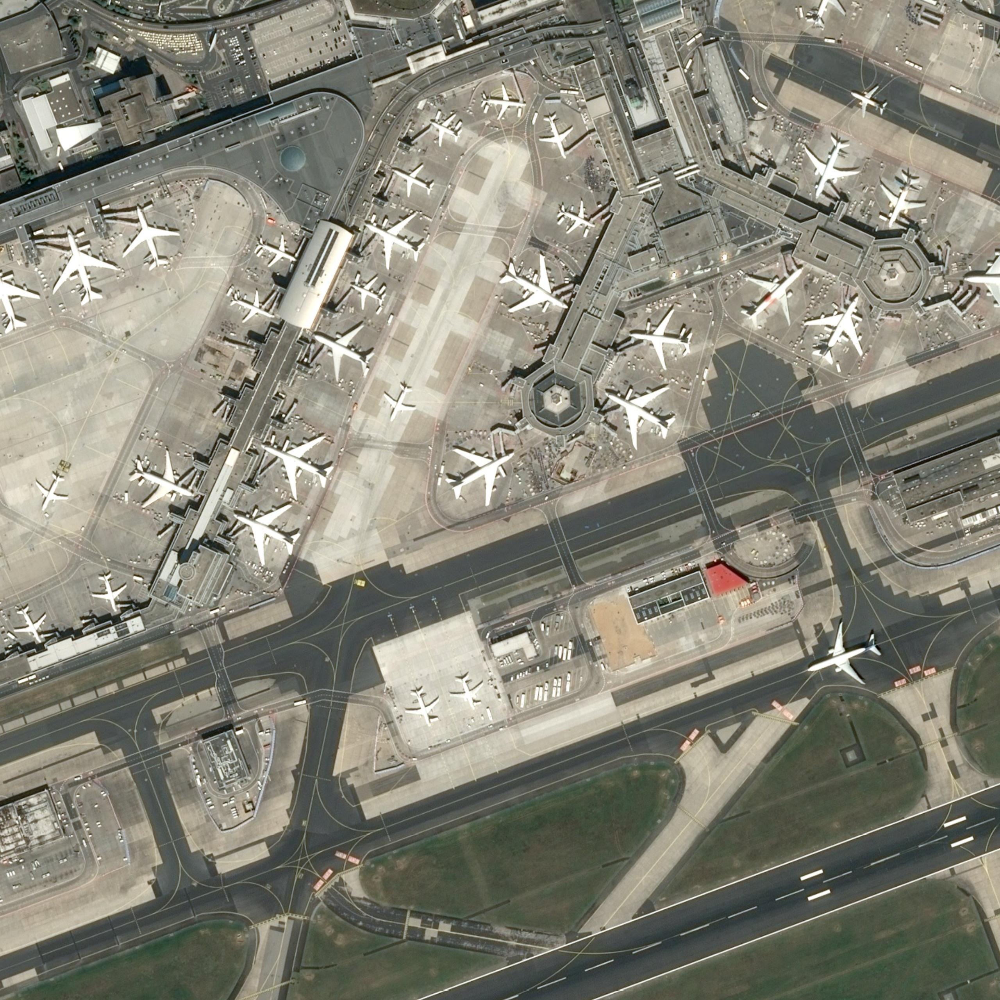

In [5]:
pickone = random.choice(img_list)
img = PIL.Image.open(pickone)
print(img.size)
display.display(img)

#### Переобробка прямокутників для облегчення малювання та аналізу датасету

In [6]:
def getBounds(geometry):
    try: 
        arr = np.array(geometry).T
        xmin = np.min(arr[0])
        ymin = np.min(arr[1])
        xmax = np.max(arr[0])
        ymax = np.max(arr[1])
        return (xmin, ymin, xmax, ymax)
    except:
        return np.nan

def getWidth(bounds):
    try: 
        (xmin, ymin, xmax, ymax) = bounds
        return np.abs(xmax - xmin)
    except:
        return np.nan

def getHeight(bounds):
    try: 
        (xmin, ymin, xmax, ymax) = bounds
        return np.abs(ymax - ymin)
    except:
        return np.nan

# Create bounds, width and height
df.loc[:,'bounds'] = df.loc[:,'geometry'].apply(getBounds)
df.loc[:,'width'] = df.loc[:,'bounds'].apply(getWidth)
df.loc[:,'height'] = df.loc[:,'bounds'].apply(getHeight)

# Display head
df.head(3)

,id,image_id,geometry,class,bounds,width,height
0,1,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(135, 522), (245, 522), (245, 600), (135, 600...",Airplane,"(135, 522, 245, 600)",110,78
1,2,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1025, 284), (1125, 284), (1125, 384), (1025,...",Airplane,"(1025, 284, 1125, 384)",100,100
2,3,4f833867-273e-4d73-8bc3-cb2d9ceb54ef.jpg,"[(1058, 1503), (1130, 1503), (1130, 1568), (10...",Airplane,"(1058, 1503, 1130, 1568)",72,65


In [7]:
unique, counts = np.unique(df['image_id'], return_counts=True)
print("Мінімальна кількість літаків на зображення: {}".format(np.min(counts)))
print("Максимальна кількість літаків на зображення: {}".format(np.max(counts)))

Мінімальна кількість літаків на зображення: 5
Максимальна кількість літаків на зображення: 92


##### Приклад правильної локалізації

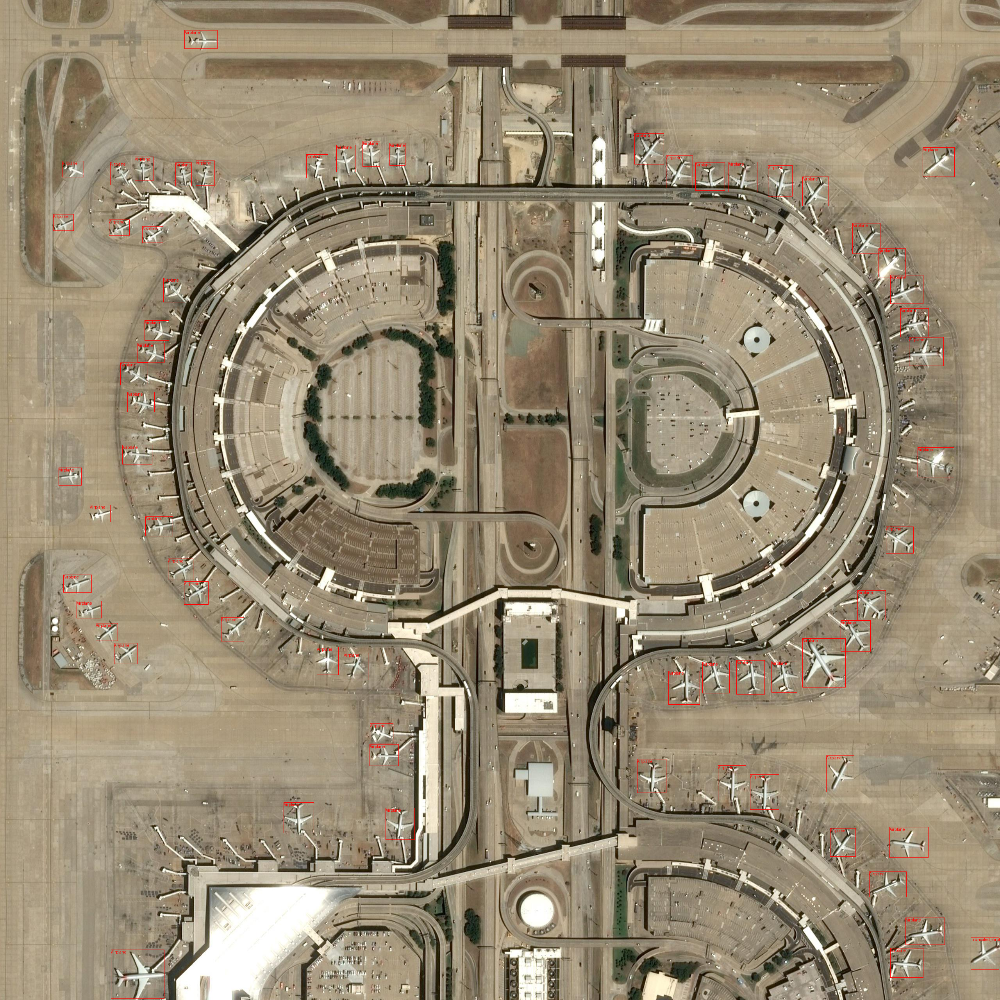

In [8]:
pickone = random.choice(img_list)
img = PIL.Image.open(pickone)
draw = PIL.ImageDraw.Draw(img)

for k, row in df[df['image_id'] == os.path.basename(pickone)].iterrows():
    draw.polygon(row['geometry'], outline=(255,0,0))
    draw.text(row['geometry'][0], row['class'], fill=(255,0,0))

display.display(img)

Сегментація зображень на 512х512 шматки за перетином на 64 пікселі (не суттєво)

In [39]:
dataset = {}
TILE_WIDTH = 512
TILE_HEIGHT = 512
TILE_OVERLAP = int(512 * 0.3)
TRUNCATED_PERCENT = 0
_overwriteFiles = True

# Save one line in .txt file for each tag found inside the tile
def tag_is_inside_tile(bounds, x_start, y_start, width, height, truncated_percent):
    x_min, y_min, x_max, y_max = bounds
    x_min, y_min, x_max, y_max = x_min - x_start, y_min - y_start, x_max - x_start, y_max - y_start

    if (x_min > width) or (x_max < 0.0) or (y_min > height) or (y_max < 0.0):
        return None
    
    x_max_trunc = min(x_max, width) 
    x_min_trunc = max(x_min, 0) 
    if (x_max_trunc - x_min_trunc) / (x_max - x_min) < truncated_percent:
        return None

    y_max_trunc = min(y_max, width) 
    y_min_trunc = max(y_min, 0) 
    if (y_max_trunc - y_min_trunc) / (y_max - y_min) < truncated_percent:
        return None
        
    x_center = (x_min_trunc + x_max_trunc) / 2.0 / width
    y_center = (y_min_trunc + y_max_trunc) / 2.0 / height
    x_extend = (x_max_trunc - x_min_trunc) / width
    y_extend = (y_max_trunc - y_min_trunc) / height
    
    return (0, x_center, y_center, x_extend, y_extend)


for img_path in img_list:
    # Open image and related data
    pil_img = PIL.Image.open(img_path, mode='r')
    np_img = np.array(pil_img, dtype=np.uint8)

    # Get annotations for image
    img_labels = df[df["image_id"] == img_path.name]
    #print(img_labels)

    # Count number of sections to make
    X_TILES = (IMAGE_WIDTH + TILE_WIDTH + TILE_OVERLAP - 1) // TILE_WIDTH 
    Y_TILES = (IMAGE_HEIGHT + TILE_HEIGHT + TILE_OVERLAP - 1) // TILE_HEIGHT
    count = -1
    # Cut each tile
    for y in range(Y_TILES):
        for x in range(X_TILES):
            count += 1

            x_end = min((x + 1) * TILE_WIDTH - TILE_OVERLAP * (x != 0), IMAGE_WIDTH)
            x_start = x_end - TILE_WIDTH
            y_end = min((y + 1) * TILE_HEIGHT - TILE_OVERLAP * (y != 0), IMAGE_HEIGHT)
            y_start = y_end - TILE_HEIGHT
            #print(x_start, y_start)

            folder = 'train'
            save_tile_path = "datasets/train/images/" + img_path.name + "_" + str(count) + ".jpg"
            save_label_path = "datasets/train/labels/" + img_path.name + "_" + str(count) + ".txt"
                
            # Save if file doesn't exit
            if _overwriteFiles or not os.path.isfile(save_tile_path):
                cut_tile = np.zeros(shape=(TILE_WIDTH, TILE_HEIGHT, 3), dtype=np.uint8)
                cut_tile[0:TILE_HEIGHT, 0:TILE_WIDTH, :] = np_img[y_start:y_end, x_start:x_end, :]
                cut_tile_img = PIL.Image.fromarray(cut_tile)
                cut_tile_img.save(save_tile_path)

            found_tags = [
                tag_is_inside_tile(bounds, x_start, y_start, TILE_WIDTH, TILE_HEIGHT, TRUNCATED_PERCENT)
                for i, bounds in enumerate(img_labels['bounds'])]
            found_tags = [el for el in found_tags if el is not None]

            dataset[img_path.name + "_" + str(count)] = found_tags
            # save labels
            with open(save_label_path, 'w+') as f:
                for tags in found_tags:
                    f.write(' '.join(str(x) for x in tags) + '\n')

In [9]:
CONFIG = """
# train and val datasets (image directory or *.txt file with image paths)
train: /mnt/c/Users/nickk/airplain_plus_datasets/airplins/datasets/train/images
val: /mnt/c/Users/nickk/airplain_plus_datasets/airplins/datasets/val/images

# number of classes
nc: 1

# class names
names: ['Aircraft']
"""

with open("datasets/data.yaml", "w") as f:
    f.write(CONFIG)

In [11]:
from ultralytics import YOLO
model = YOLO("yolov9c.pt")

In [12]:
results = model.train(data="/mnt/c/Users/nickk/airplain_plus_datasets/airplins/datasets/data.yaml", epochs=10, imgsz=512)

New https://pypi.org/project/ultralytics/8.3.0 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.2.100 🚀 Python-3.12.2 torch-2.4.1+cu121 CUDA:0 (NVIDIA GeForce MX230, 2048MiB)
engine/trainer: task=detect, mode=train, model=yolov9c.pt, data=/mnt/c/Users/nickk/airplain_plus_datasets/airplins/datasets/data.yaml, epochs=10, time=None, patience=100, batch=16, imgsz=512, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None

train: Scanning /mnt/c/Users/nickk/airplain_plus_datasets/airplins/datasets/train/labels.cache... 3672 images, 1500 backgrounds, 0 corrupt: 100%|██████████| 3672/3672 [00:00<?, ?it/s]

train: WARNING ⚠️ /mnt/c/Users/nickk/airplain_plus_datasets/airplins/datasets/train/images/7635d63c-6b97-4c9c-a7dc-27773d42ed4c.jpg_22.jpg: 1 duplicate labels removed



val: Scanning /mnt/c/Users/nickk/airplain_plus_datasets/airplins/datasets/val/labels.cache... 36 images, 21 backgrounds, 0 corrupt: 100%|██████████| 36/36 [00:00<?, ?it/s]


: 

In [10]:
HOME = "/mnt/c/Users/nickk/airplain_plus_datasets/"
!yolo task=detect mode=train model=yolov9c.pt data=/mnt/c/Users/nickk/airplain_plus_datasets/airplins/datasets/data.yaml epochs=10 imgsz=512

New https://pypi.org/project/ultralytics/8.3.0 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.2.100 🚀 Python-3.12.2 torch-2.4.1+cu121 CUDA:0 (NVIDIA GeForce MX230, 2048MiB)
engine/trainer: task=detect, mode=train, model=yolov9c.pt, data=/mnt/c/Users/nickk/airplain_plus_datasets/airplins/datasets/data.yaml, epochs=10, time=None, patience=100, batch=16, imgsz=512, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None